## Imports

In [1]:
from sklearn.feature_extraction.text import TfidfVectorizer
from collections import Counter
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_score
import umap.umap_ as umap
import string
import time
from gensim import corpora, models
import gensim
from nltk.tokenize import word_tokenize
import nltk
from stop_words import get_stop_words
from sklearn.datasets import fetch_20newsgroups
from scipy.sparse import save_npz
from pprint import pprint
import re
from tqdm import tqdm

nltk.download('punkt')
stop_words = get_stop_words('en')

/Users/srsawant/miniconda3/envs/torch/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
[nltk_data] Downloading package punkt to /Users/srsawant/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


## Data Clean and Preprocess

In [2]:
class NewsGroupDataset:
    
    def __init__(self,):
        pass

    def get_20newsgroup_data(self, ):

        newsgroups_train = fetch_20newsgroups(subset='train')
        num_topics = len( set(newsgroups_train.target_names) )
        # pprint(list(newsgroups_train.target_names))

        raw_sentences = []
        for s in tqdm(newsgroups_train.data):
            raw_sentences.append( s )
        
        return raw_sentences, num_topics

    def only_letters(self, tested_string):
        for letter in tested_string:
            if letter not in "abcdefghijklmnopqrstuvwxyz":
                return False
        return True

    def clean_data(self, s):
        s = s.replace(">","").lower()
        if "lines:" in s :
            index = s.index("lines:")
            s = s[index+10:]

        word_list = word_tokenize(s)
        cleaned = []
        for w in word_list:
            if w not in stop_words:
                if w in string.punctuation or self.only_letters(w):
                    if w in string.punctuation or len( set(w) ) > 1:
                        cleaned.append( w)
        return " ".join(cleaned) ,cleaned

    def build_data(self, docs):

        n_docs = len(docs)
        sentences = [] 
        token_lists = [] 

        for i in tqdm( range(len(docs)) ):
            sentence,token_list = self.clean_data(docs[i])
            if token_list:
                sentences.append(sentence)
                token_lists.append(token_list)

        return sentences, token_lists

In [3]:
dataset = NewsGroupDataset()
raw_sentences, num_topics = dataset.get_20newsgroup_data()
sentences, token_lists = dataset.build_data( raw_sentences )

print("num_topics : ",num_topics )
print("\n------------- Sample raw sentence -------------\n", raw_sentences[10])
print("\n------------- Sentence after cleaning -------------\n", sentences[10])
print("\nNum of sentences: ",len(sentences))


100%|██████████| 11314/11314 [00:15<00:00, 748.05it/s]

num_topics :  20

------------- Sample raw sentence -------------
 From: irwin@cmptrc.lonestar.org (Irwin Arnstein)
Subject: Re: Recommendation on Duc
Summary: What's it worth?
Distribution: usa
Expires: Sat, 1 May 1993 05:00:00 GMT
Organization: CompuTrac Inc., Richardson TX
Keywords: Ducati, GTS, How much? 
Lines: 13

I have a line on a Ducati 900GTS 1978 model with 17k on the clock.  Runs
very well, paint is the bronze/brown/orange faded out, leaks a bit of oil
and pops out of 1st with hard accel.  The shop will fix trans and oil 
leak.  They sold the bike to the 1 and only owner.  They want $3495, and
I am thinking more like $3K.  Any opinions out there?  Please email me.
Thanks.  It would be a nice stable mate to the Beemer.  Then I'll get
a jap bike and call myself Axis Motors!

-- 
-----------------------------------------------------------------------
"Tuba" (Irwin)      "I honk therefore I am"     CompuTrac-Richardson,Tx
irwin@cmptrc.lonestar.org    DoD #0826          (R75/6)


## TFIDF

In [14]:
class ReduceDim:
    
    def __init__(self, embeddings):
        self.embedding = embeddings

    def reduce_umap(self,):
        reducer = umap.UMAP() #umap.UMAP()
        embedding_umap = reducer.fit_transform( self.embedding  )
        return embedding_umap

    def reduce_pca(self,):
        pca = PCA(n_components=2)
        reduced = pca.fit_transform( self.embedding )
        print( "pca explained_variance_ ",pca.explained_variance_)
        print( "pca explained_variance_ratio_ ",pca.explained_variance_ratio_)

        return reduced

    def reduce_tsne(self,):
        tsne = TSNE(n_components=2, init='random')
        reduced = tsne.fit_transform( self.embedding )

        return reduced

#get tfidf of documents
def get_tfidf_embedding(items):
    tfidf = TfidfVectorizer()
    embeddings = tfidf.fit_transform(items)
    return embeddings

# Predict the topics using Kmeans algo
def predict_topics_with_kmeans(embeddings, num_topics):
    kmeans_model = KMeans(num_topics)
    kmeans_model.fit(embeddings)
    topics_labels = kmeans_model.predict(embeddings)
    return topics_labels

# Plotting the cluster
def plot_embeddings(embedding, labels, title):

    labels = np.array( labels )
    distinct_labels =  set( labels )

    n = len(embedding)
    counter = Counter(labels)
    for i in range(len( distinct_labels )):
        ratio = (counter[i] / n )* 100
        cluster_label = f"cluster {i}: { round(ratio,2)} %"
        x = embedding[:, 0][labels == i]
        y = embedding[:, 1][labels == i]
        plt.plot(x, y, '.', alpha=0.4, label= cluster_label)
    plt.legend(title="Topic",loc = 'upper left', bbox_to_anchor=(1.01,1))
    plt.title(title)

In [8]:
# Generate embedding with tfidf
embedding_tf_idf = get_tfidf_embedding( sentences )
# Dimension reduction with Umap, TSNE, PCA
reduceDim = ReduceDim(embedding_tf_idf)
embedding_tf_idf_umap =  reduceDim.reduce_umap()
embedding_tf_idf_tsne =  reduceDim.reduce_tsne()

# Finding predicted labels
labels_tfidf_raw  = predict_topics_with_kmeans(embedding_tf_idf,num_topics)
labels_tfidf_umap  = predict_topics_with_kmeans(embedding_tf_idf_umap,num_topics)
labels_tfidf_tsne  = predict_topics_with_kmeans(embedding_tf_idf_tsne,num_topics)

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.
/Users/srsawant/miniconda3/envs/torch/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/srsawant/miniconda3/envs/torch/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/srsawant/miniconda3/envs/torch/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [9]:
# Saving embeddings and labels
save_npz('embeddings/embedding_tf_idf_raw.npz', embedding_tf_idf)
np.save('embeddings/embedding_tf_idf_umap.npy', embedding_tf_idf_umap)
np.save('embeddings/embedding_tf_idf_tsne.npy', embedding_tf_idf_tsne)

np.save('labels/labels_tfidf_raw.npy', labels_tfidf_raw)
np.save('labels/labels_tfidf_umap.npy', labels_tfidf_umap)
np.save('labels/labels_tfidf_tsne.npy', labels_tfidf_tsne)

In [10]:
# Loading embeddings and labels
# from scipy.sparse import load_npz

# # Load the csr_matrix from the .npz file
# embedding_tf_idf = load_npz('embeddings/embedding_tf_idf_raw.npz')
# embedding_tf_idf_umap = np.load('embeddings/embedding_tf_idf_umap.npy')
# embedding_tf_idf_tsne = np.load('embeddings/embedding_tf_idf_tsne.npy')

# # Load labels
# labels_tfidf_raw = np.load('labels/labels_tfidf_raw.npy')
# labels_tfidf_umap = np.load('labels/labels_tfidf_umap.npy')
# labels_tfidf_tsne = np.load('labels/labels_tfidf_tsne.npy')

Embedding Tf-idf shape : (11300, 70990)
Embedding shape after umap (11300, 2)


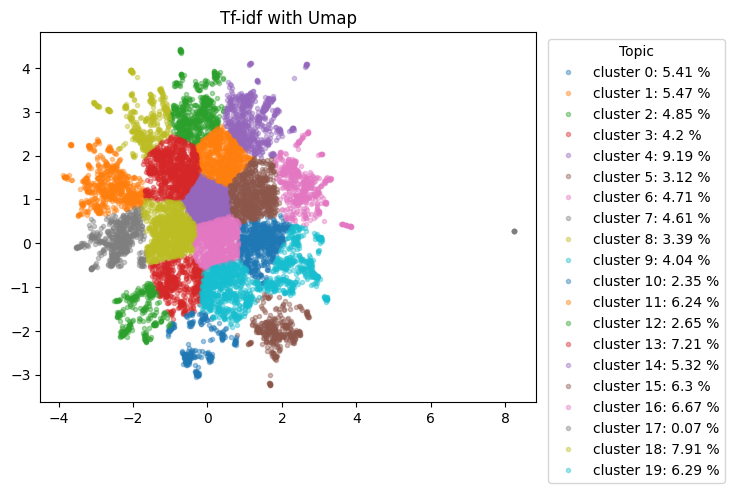

In [15]:
# Plotting
print("Embedding Tf-idf shape :",embedding_tf_idf.shape)

# 1. Umap
print("Embedding shape after umap",embedding_tf_idf_umap.shape)
plot_embeddings(embedding_tf_idf_umap,labels_tfidf_umap,"Tf-idf with Umap")

Embedding shape after tsne (11300, 2)


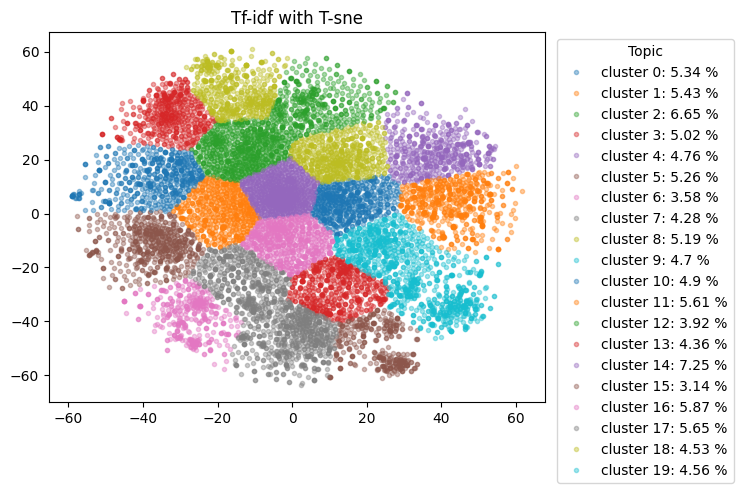

In [16]:
# 2. T-sne
print("Embedding shape after tsne",embedding_tf_idf_tsne.shape)
plot_embeddings(embedding_tf_idf_tsne,labels_tfidf_tsne,"Tf-idf with T-sne")

The silhouette value is a measure of how similar an object is to its own cluster compared to other clusters

The best value is 1 and the worst value is -1. Values near 0 indicate overlapping clusters.
Negative values generally indicate that a sample has
been assigned to the wrong cluster, as a different cluster is more similar.

In [17]:
print("Silhouette score:" )
print("without dim reduction :", silhouette_score(embedding_tf_idf , labels_tfidf_raw) )
print("with Tf-idf   Umap    :", silhouette_score(embedding_tf_idf_umap, labels_tfidf_umap) )
print("with Tf-idf   T-sne   :",  silhouette_score(embedding_tf_idf_tsne, labels_tfidf_tsne) )

Silhouette score:
without dim reduction : 0.00522477849746918
with Tf-idf   Umap    : 0.36148784
with Tf-idf   T-sne   : 0.35478404


## LDA

In [71]:
class LDAModel:

  def __init__(self, num_topics, token_lists):
    self.num_topics = num_topics
    self.dictionary = corpora.Dictionary(token_lists)
    self.corpus = [self.dictionary.doc2bow(text) for text in token_lists]
  
  def get_dictionary(self,):
    return self.dictionary

  def get_corpus(self,):
    return self.corpus

  def get_lda_model(self,):
    return gensim.models.ldamodel.LdaModel(self.corpus, num_topics=self.num_topics, id2word=self.dictionary, passes=20)

  def get_document_topic_lda(self, model):
    n_doc = len(self.corpus)
    #init a vector of size number of docs x clusters
    document_topic_mapping = np.zeros((n_doc, self.num_topics))
    for i in range(n_doc):
      # for each document create a vector of probability document belonging to topic
      for topic, prob in model.get_document_topics(self.corpus[i]):
        document_topic_mapping[i, topic] = prob

    return document_topic_mapping
  
  def get_labels(self, lda_model):
    labels_lda = []
    for line in self.corpus :
      line_labels = sorted( lda_model.get_document_topics( line ) , key=lambda x: x[1], reverse=True)
      # Sample line_label: [(<topic_id_1>, <prob_1>), (<topic_id_2>, <prob_2>), ...]
      # 1st 0 is for selecting top item, and 2nd 0 is for index of tuple
      top_topic = line_labels[0][0]
      labels_lda.append( top_topic )
    
    return np.array(labels_lda)

In [72]:
ldaModel = LDAModel(num_topics=num_topics, token_lists=token_lists)
dictionary, corpus = ldaModel.get_dictionary(), ldaModel.get_corpus()
lda_model = ldaModel.get_lda_model()
embedding_lda = ldaModel.get_document_topic_lda(lda_model)
labels_lda = ldaModel.get_labels(lda_model)

In [81]:
item_idx = 100
token_idx = 114
print(f"Number of tokens : {len( token_lists )}\n")

print(f"Sample item from corpus length (100 idx): {len( corpus[item_idx] )}")
print(f"Sample item sentence: {token_lists[item_idx]}")
print(f"Sample item from corpus vector (100 idx): {corpus[item_idx]}\n")

print(f"Token 114 is id for: {dictionary.id2token[token_idx]}")
print(f"Count for '{dictionary.id2token[token_idx]}' in item idx-{item_idx}: {list(token_lists[item_idx]).count(dictionary.id2token[token_idx])}")

Number of tokens : 11300

Sample item from corpus length (100 idx): 55
Sample item sentence: ['software', 'publishing', 'superbase', 'windows', '-', '$', 'ocr', 'system', 'readright', 'windows', '-', '$', 'ocr', 'system', 'readright', 'dos', '-', '$', 'unregistered', 'zortech', 'bit', 'compiler', '-', '$', 'multiscope', 'windows', 'debugger', ',', 'whitewater', 'resource', 'toolkit', ',', 'library', 'source', 'code', 'commonview', 'windows', 'applications', 'framework', 'borland', '-', '$', 'spontaneous', 'assembly', 'library', 'source', 'code', '-', '$', 'microsoft', 'macro', 'assembly', '-', '$', 'microsoft', 'windows', 'sdk', 'documentation', '-', '$', 'microsoft', 'foxpro', '-', '$', 'wordperfect', 'developer', 'toolkit', '-', '$', 'kedwell', 'software', 'databoss', 'code', 'generator', '-', '$', 'kedwell', 'installboss', 'installation', 'generator', '-', '$', 'liant', 'software', 'windows', 'application', 'framework', 'source', 'code', '-', '$', 'ibm', '&', 'developer', 'toolkit',

In [82]:
print("Number of words in token list :", len( token_lists ))
print("LDA vector shape :", embedding_lda.shape )

# Each sentence will have prob distribution of topic (20 topics)
for i,topic in enumerate(embedding_lda[10].flatten()):
    print("Topic ",i+1,") ", embedding_lda[10].flatten()[i])


Number of words in token list : 11300
LDA vector shape : (11300, 20)
Topic  1 )  0.0
Topic  2 )  0.0
Topic  3 )  0.3582116663455963
Topic  4 )  0.08139320462942123
Topic  5 )  0.0
Topic  6 )  0.0
Topic  7 )  0.0
Topic  8 )  0.0
Topic  9 )  0.0
Topic  10 )  0.0
Topic  11 )  0.0
Topic  12 )  0.0
Topic  13 )  0.014601379632949829
Topic  14 )  0.0368892177939415
Topic  15 )  0.0
Topic  16 )  0.0
Topic  17 )  0.0
Topic  18 )  0.0
Topic  19 )  0.0
Topic  20 )  0.4984540641307831


In [83]:
lda_model.get_document_topics( corpus[100] )

[(3, 0.5477098), (6, 0.277062), (13, 0.16704234)]

Since LDA already has a low dimension num_topic ( 20 ) , dimension reductions
will not yield good results

In [84]:
reduce_lda = ReduceDim( embedding_lda )
embedding_lda_umap = reduce_lda.reduce_umap()
embedding_lda_pca = reduce_lda.reduce_pca()
embedding_lda_tsne = reduce_lda.reduce_tsne()

pca explained_variance_  [0.09867981 0.0565137 ]
pca explained_variance_ratio_  [0.31115567 0.17819814]


In [90]:
# Save model, embedding and labels
lda_model.save('models/lda/newsgroup_lda_model.model')
np.save('embeddings/embedding_lda.npy', embedding_lda)
np.save('embeddings/embedding_lda_umap.npy', embedding_lda_umap)
np.save('embeddings/embedding_lda_pca.npy', embedding_lda_pca)
np.save('embeddings/embedding_lda_tsne.npy', embedding_lda_tsne)
np.save('labels/labels_lda.npy', labels_lda)

In [95]:
# # Load model, embedding and labels
# lda_model = models.LdaModel.load('models/lda/newsgroup_lda_model.model')
# embedding_lda = np.load('embeddings/embedding_lda.npy')
# embedding_lda_umap = np.load('embeddings/embedding_lda_umap.npy')
# embedding_lda_pca = np.load('embeddings/embedding_lda_pca.npy')
# embedding_lda_tsne = np.load('embeddings/embedding_lda_tsne.npy')
# labels_lda = np.load('labels/labels_lda.npy')

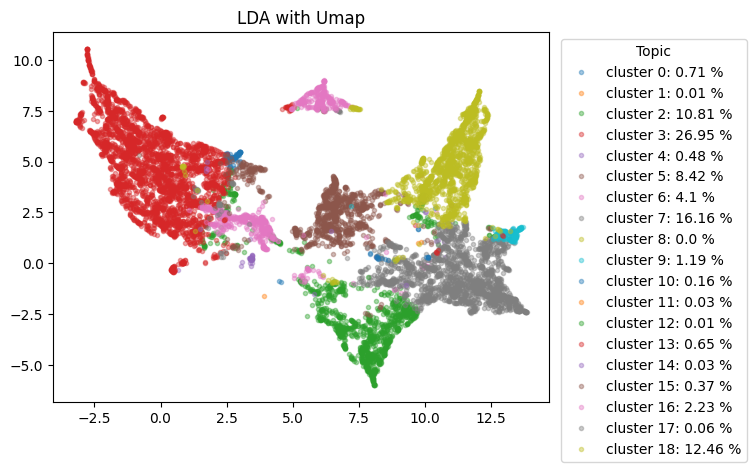

In [91]:
plot_embeddings(embedding_lda_umap, labels_lda,"LDA with Umap")

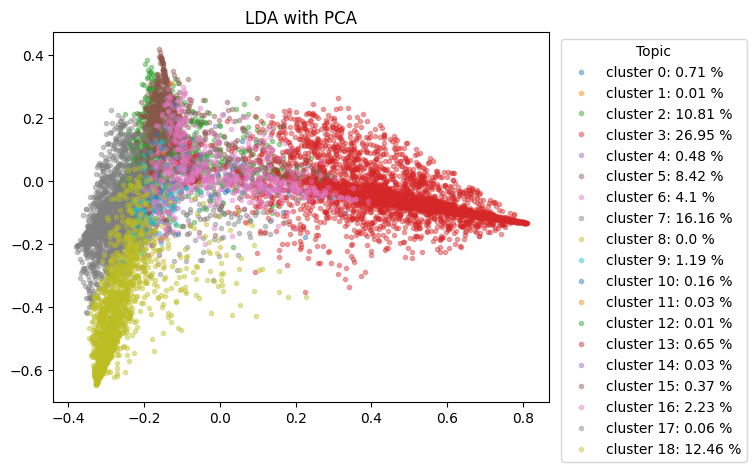

In [92]:
plot_embeddings(embedding_lda_pca, labels_lda,"LDA with PCA")

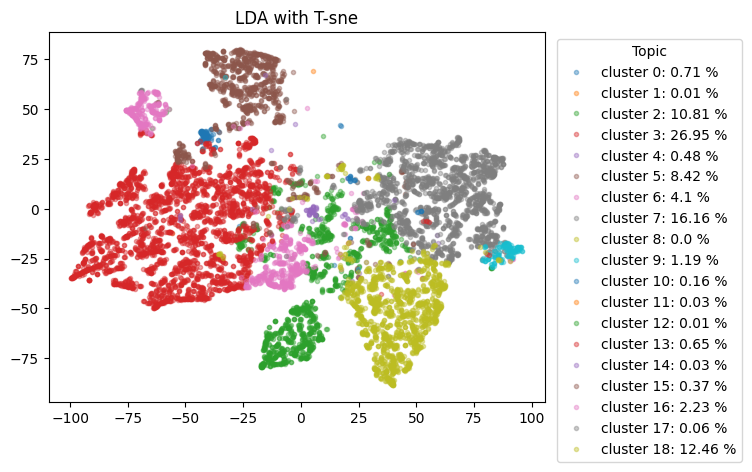

In [93]:
plot_embeddings(embedding_lda_tsne, labels_lda,"LDA with T-sne")

In [94]:
print("Silhouette score:" )
print("LDA          : ", silhouette_score(embedding_lda, labels_lda) )
print("LDA with PCA : ", silhouette_score(embedding_lda_umap, labels_lda) )
print("LDA with TSNE : ", silhouette_score(embedding_lda_pca, labels_lda) )
print("LDA with UMAP : ", silhouette_score(embedding_lda_tsne, labels_lda) )

Silhouette score:
LDA          :  0.33248994700223783
LDA with PCA :  0.029784784
LDA with TSNE :  0.02772869591790107
LDA with UMAP :  -0.06296385


## BERT

In [96]:
from sentence_transformers import SentenceTransformer

model_bert = SentenceTransformer('bert-base-nli-max-tokens')
embedding_bert = np.array(model_bert.encode(sentences, show_progress_bar=True))
#Bert embeddings are shape of 768
print("Bert Embedding shape", embedding_bert.shape)
print("Bert Embedding sample", embedding_bert[0][0:50])

Batches: 100%|██████████| 354/354 [14:12<00:00,  2.41s/it]


Bert Embedding shape (11300, 768)
Bert Embedding sample [ 0.4772095   1.4122603   1.2466787   0.25712287  1.3472146   0.05440226
  0.5105703   0.53572464  0.8825289  -0.00200348  1.2273113   1.386246
  1.5305257   0.35194874  0.07823875  0.6897573   1.7512572   1.0708537
  1.1696905   0.65206015 -0.0396474  -0.01581196  0.7216684   0.05700484
  1.2987406   1.5801789   0.7318033   1.0034963  -0.50588197 -0.04584549
  0.17520934  1.590841    0.5122798   0.75427216  0.9528044   0.5564434
  0.8194803   0.05092426  0.2616545   0.9130401   0.63735116  0.4096313
  0.78955173  0.4644488  -0.31118912  1.149906    0.7721692   1.4973224
  0.638161    1.0090789 ]


In [97]:
#Apply Kmeans without dimension reduction
labels_bert_raw  = predict_topics_with_kmeans(embedding_bert,num_topics)

# Dimension reductions
reduce_bert = ReduceDim( embedding_bert )
embedding_bert_umap = reduce_bert.reduce_umap()
embedding_bert_pca =  reduce_bert.reduce_pca()
embedding_bert_tsne =  reduce_bert.reduce_tsne()

# Predicting labels with Kmeans
labels_bert_umap  = predict_topics_with_kmeans(embedding_bert_umap, num_topics)
labels_bert_pca  = predict_topics_with_kmeans(embedding_bert_pca, num_topics)
labels_bert_tsne  = predict_topics_with_kmeans(embedding_bert_tsne, num_topics)

/Users/srsawant/miniconda3/envs/torch/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


pca explained_variance_  [10.201156  5.783819]
pca explained_variance_ratio_  [0.09940006 0.05635753]


/Users/srsawant/miniconda3/envs/torch/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/srsawant/miniconda3/envs/torch/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/srsawant/miniconda3/envs/torch/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [98]:
# Save embedding
np.save('embeddings/embedding_bert.npy', embedding_bert)
np.save('embeddings/embedding_bert_umap.npy', embedding_bert_umap)
np.save('embeddings/embedding_bert_pca.npy', embedding_bert_pca)
np.save('embeddings/embedding_bert_tsne.npy', embedding_bert_tsne)

# Save labels
np.save('labels/labels_bert_raw.npy', labels_bert_raw)
np.save('labels/labels_bert_umap.npy', labels_bert_umap)
np.save('labels/labels_bert_pca.npy', labels_bert_pca)
np.save('labels/labels_bert_tsne.npy', labels_bert_tsne)

In [99]:
# # Load embedding and labels
# embedding_bert = np.load('embeddings/embedding_bert.npy')
# embedding_bert_umap = np.load('embeddings/embedding_bert_umap.npy')
# embedding_bert_pca = np.load('embeddings/embedding_bert_pca.npy')
# embedding_bert_tsne = np.load('embeddings/embedding_bert_tsne.npy')

# labels_bert_raw = np.load('labels/labels_bert_raw.npy')
# labels_bert_umap = np.load('labels/labels_bert_umap.npy')
# labels_bert_pca = np.load('labels/labels_bert_pca.npy')
# labels_bert_tsne = np.load('labels/labels_bert_tsne.npy')

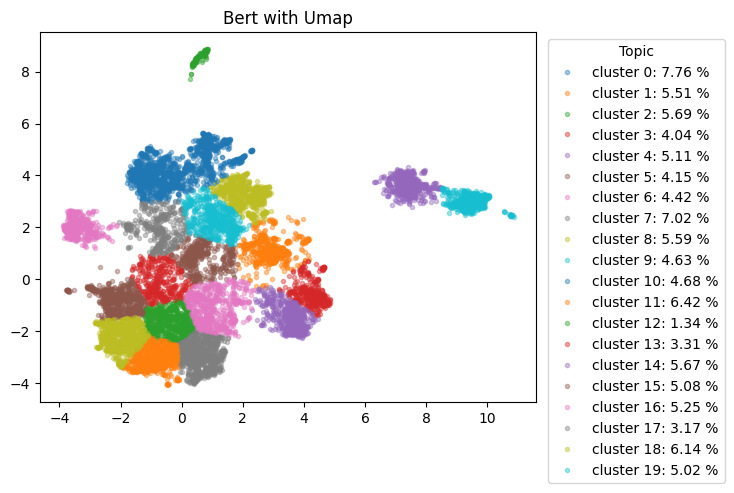

In [100]:
plot_embeddings(embedding_bert_umap, labels_bert_umap,"Bert with Umap")

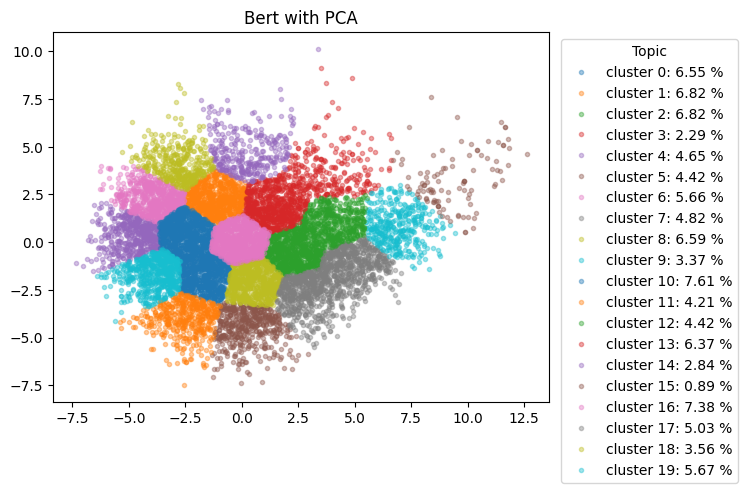

In [101]:
plot_embeddings(embedding_bert_pca,labels_bert_pca,"Bert with PCA")

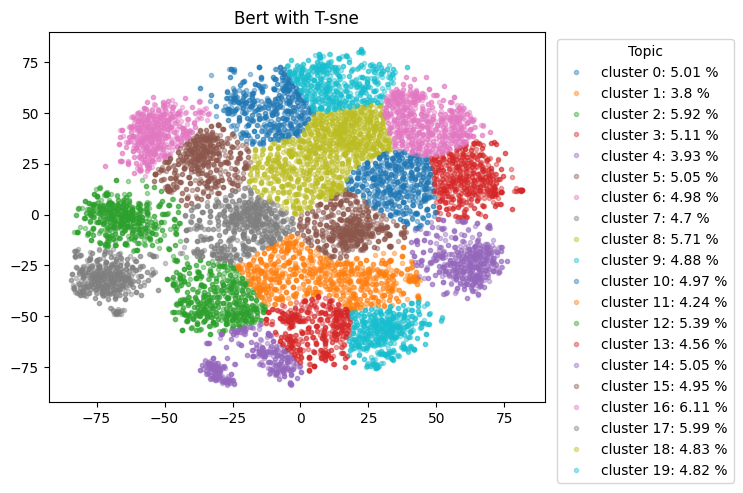

In [102]:
plot_embeddings(embedding_bert_tsne,labels_bert_tsne,"Bert with T-sne")

In [103]:
print("Silhouette score:" )
print("Raw Bert" ,silhouette_score(embedding_bert, labels_bert_raw) )
print("Bert with Umap" ,  silhouette_score(embedding_bert_umap, labels_bert_umap ) )
print("Bert with PCA" ,  silhouette_score(embedding_bert_pca, labels_bert_pca) )
print("Bert with Tsne" , silhouette_score(embedding_bert_tsne, labels_bert_tsne) )

Silhouette score:
Raw Bert 0.046671692
Bert with Umap 0.46427682
Bert with PCA 0.3237192
Bert with Tsne 0.38390258


## DeBERTa

In [104]:
model_deberta = SentenceTransformer('embedding-data/deberta-sentence-transformer')
embedding_deberta = np.array(model_deberta.encode(sentences, show_progress_bar=True))

#DeBERTa embeddings are shape of 768
print("DeBERTa Embedding shape", embedding_deberta.shape)
print("DeBERTa Embedding sample", embedding_deberta[0][0:50])

Batches: 100%|██████████| 354/354 [1:15:34<00:00, 12.81s/it]    


DeBERTa Embedding shape (11300, 768)
DeBERTa Embedding sample [ 0.89414626  0.18023881  0.6540974  -0.55542374  0.36901635 -0.50254583
 -0.37689313 -0.21301827 -0.3580452   0.10842506  0.03751123 -4.221807
 -0.5369132   0.9998138  -0.16522166 -0.39119843  0.1474407  -0.54161626
  0.2890753   0.00629923 -0.4853416   0.02485328 -0.6480601  -0.68066823
  0.09306238 -0.28994316  0.16142784  0.37139106  0.7767223   0.2969222
  0.42010498  0.6919884   0.28055462  0.1415811   0.28863543 -0.16064364
  0.21024865 -0.95749575  0.79837054 -0.95518607  0.0496834   0.31941321
 -0.13216157  0.8318466   0.10781463  0.2068401   0.96596617  0.4710616
 -0.7390946   0.24006785]


In [105]:
#Apply Kmeans without dimension reduction
labels_deberta_raw  = predict_topics_with_kmeans(embedding_deberta, num_topics)

# Dimension reductions
reduce_deberta = ReduceDim( embedding_deberta )
embedding_deberta_umap = reduce_deberta.reduce_umap()
embedding_deberta_pca =  reduce_deberta.reduce_pca()
embedding_deberta_tsne =  reduce_deberta.reduce_tsne()

# Predicting labels with Kmeans
labels_deberta_umap  = predict_topics_with_kmeans(embedding_deberta_umap, num_topics)
labels_deberta_pca  = predict_topics_with_kmeans(embedding_deberta_pca, num_topics)
labels_deberta_tsne  = predict_topics_with_kmeans(embedding_deberta_tsne, num_topics)

/Users/srsawant/miniconda3/envs/torch/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


pca explained_variance_  [27.513527 21.824242]
pca explained_variance_ratio_  [0.29321915 0.23258689]


/Users/srsawant/miniconda3/envs/torch/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/srsawant/miniconda3/envs/torch/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/srsawant/miniconda3/envs/torch/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [106]:
# Save embedding
np.save('embeddings/embedding_deberta.npy', embedding_deberta)
np.save('embeddings/embedding_deberta_umap.npy', embedding_deberta_umap)
np.save('embeddings/embedding_deberta_pca.npy', embedding_deberta_pca)
np.save('embeddings/embedding_deberta_tsne.npy', embedding_deberta_tsne)

# Save labels
np.save('labels/labels_deberta_raw.npy', labels_deberta_raw)
np.save('labels/labels_deberta_umap.npy', labels_deberta_umap)
np.save('labels/labels_deberta_pca.npy', labels_deberta_pca)
np.save('labels/labels_deberta_tsne.npy', labels_deberta_tsne)

In [107]:
# # Load embedding and labels
# embedding_deberta = np.load('embeddings/embedding_deberta.npy')
# embedding_deberta_umap = np.load('embeddings/embedding_deberta_umap.npy')
# embedding_deberta_pca = np.load('embeddings/embedding_deberta_pca.npy')
# embedding_deberta_tsne = np.load('embeddings/embedding_deberta_tsne.npy')

# labels_deberta_raw = np.load('labels/labels_deberta_raw.npy')
# labels_deberta_umap = np.load('labels/labels_deberta_umap.npy')
# labels_deberta_pca = np.load('labels/labels_deberta_pca.npy')
# labels_deberta_tsne = np.load('labels/labels_deberta_tsne.npy')

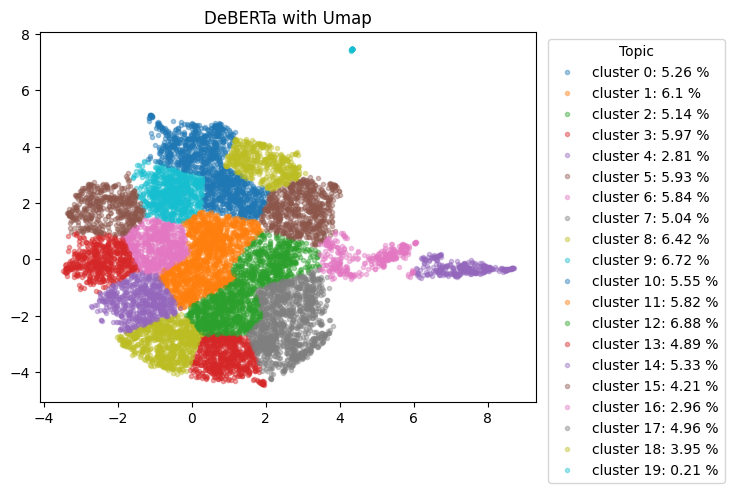

In [108]:
plot_embeddings(embedding_deberta_umap, labels_deberta_umap,"DeBERTa with Umap")

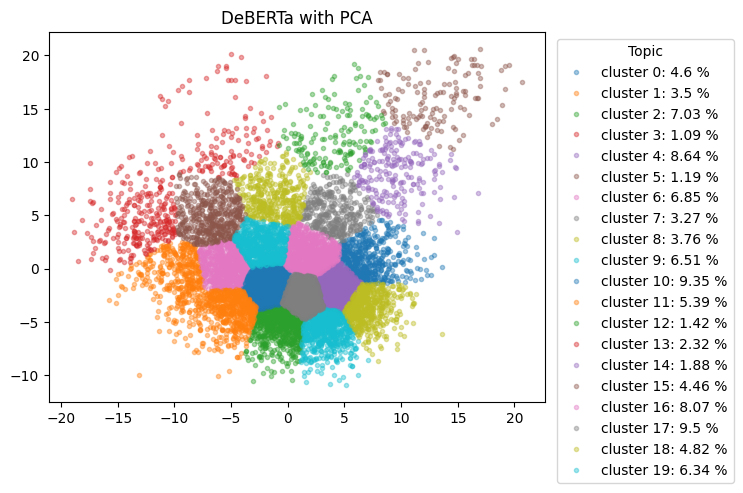

In [109]:
plot_embeddings(embedding_deberta_pca,labels_deberta_pca,"DeBERTa with PCA")

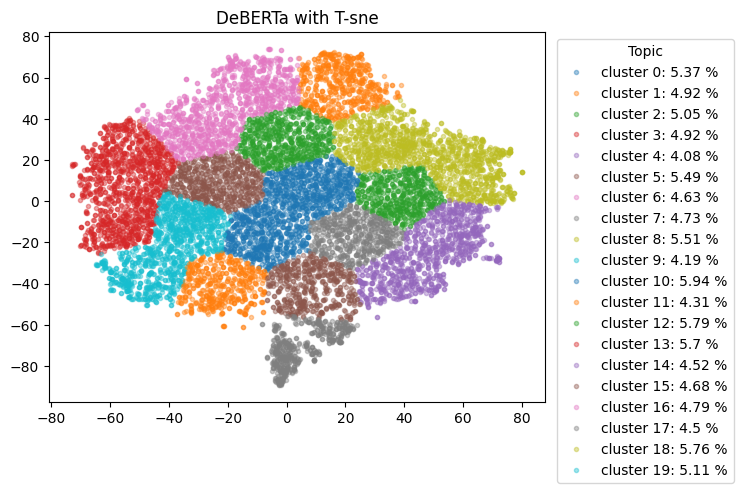

In [110]:
plot_embeddings(embedding_deberta_tsne,labels_deberta_tsne,"DeBERTa with T-sne")

In [111]:
print("Silhouette score:" )
print("Raw DeBERTa" ,silhouette_score(embedding_deberta, labels_deberta_raw) )
print("DeBERTa with Umap" ,  silhouette_score(embedding_deberta_umap, labels_deberta_umap ) )
print("DeBERTa with PCA" ,  silhouette_score(embedding_deberta_pca, labels_deberta_pca) )
print("DeBERTa with Tsne" , silhouette_score(embedding_deberta_tsne, labels_deberta_tsne) )

Silhouette score:
Raw DeBERTa 0.06479726
DeBERTa with Umap 0.3662115
DeBERTa with PCA 0.32069647
DeBERTa with Tsne 0.35843325


## RoBERTa

In [114]:
model_roberta = SentenceTransformer('sentence-transformers/all-roberta-large-v1')
embedding_roberta = np.array(model_roberta.encode(sentences, show_progress_bar=True))

#RoBERTa embeddings are shape of 1024
print("RoBERTa Embedding shape", embedding_roberta.shape)
print("RoBERTa Embedding sample", embedding_roberta[0][0:50])

Batches: 100%|██████████| 354/354 [45:18<00:00,  7.68s/it]


RoBERTa Embedding shape (11300, 1024)
RoBERTa Embedding sample [-0.02997734  0.00868174  0.04342556 -0.02873888 -0.00524096 -0.0561776
  0.00858744  0.01581427  0.00662437  0.02870977 -0.0051499  -0.04445913
 -0.00453536  0.02430977  0.01241557 -0.02905354  0.02688452  0.01238434
  0.02278607  0.00374913 -0.04324316  0.01446176 -0.00803619 -0.002347
 -0.0048073   0.02961459 -0.01863622 -0.04845725 -0.03540197  0.01901474
 -0.00219237 -0.01425987  0.01595886  0.04929223  0.00837302  0.01130989
  0.00141169 -0.02944959  0.03125485 -0.00617644 -0.01230322 -0.06535363
 -0.0364381   0.04254188 -0.00263549 -0.01947916  0.02662602  0.06214504
  0.02202569 -0.00514736]


In [115]:
#Apply Kmeans without dimension reduction
labels_roberta_raw  = predict_topics_with_kmeans(embedding_roberta, num_topics)

# Dimension reductions
reduce_roberta = ReduceDim( embedding_roberta )
embedding_roberta_umap = reduce_roberta.reduce_umap()
embedding_roberta_pca =  reduce_roberta.reduce_pca()
embedding_roberta_tsne =  reduce_roberta.reduce_tsne()

# Predicting labels with Kmeans
labels_roberta_umap  = predict_topics_with_kmeans(embedding_roberta_umap, num_topics)
labels_roberta_pca  = predict_topics_with_kmeans(embedding_roberta_pca, num_topics)
labels_roberta_tsne  = predict_topics_with_kmeans(embedding_roberta_tsne, num_topics)

/Users/srsawant/miniconda3/envs/torch/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


pca explained_variance_  [0.0535301  0.02864548]
pca explained_variance_ratio_  [0.06645223 0.03556048]


/Users/srsawant/miniconda3/envs/torch/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/srsawant/miniconda3/envs/torch/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/srsawant/miniconda3/envs/torch/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [116]:
# Save embedding
np.save('embeddings/embedding_roberta.npy', embedding_roberta)
np.save('embeddings/embedding_roberta_umap.npy', embedding_roberta_umap)
np.save('embeddings/embedding_roberta_pca.npy', embedding_roberta_pca)
np.save('embeddings/embedding_roberta_tsne.npy', embedding_roberta_tsne)

# Save labels
np.save('labels/labels_roberta_raw.npy', labels_roberta_raw)
np.save('labels/labels_roberta_umap.npy', labels_roberta_umap)
np.save('labels/labels_roberta_pca.npy', labels_roberta_pca)
np.save('labels/labels_roberta_tsne.npy', labels_roberta_tsne)

In [117]:
# # Load embedding and labels
# embedding_roberta = np.load('embeddings/embedding_roberta.npy')
# embedding_roberta_umap = np.load('embeddings/embedding_roberta_umap.npy')
# embedding_roberta_pca = np.load('embeddings/embedding_roberta_pca.npy')
# embedding_roberta_tsne = np.load('embeddings/embedding_roberta_tsne.npy')

# labels_roberta_raw = np.load('labels/labels_roberta_raw.npy')
# labels_roberta_umap = np.load('labels/labels_roberta_umap.npy')
# labels_roberta_pca = np.load('labels/labels_roberta_pca.npy')
# labels_roberta_tsne = np.load('labels/labels_roberta_tsne.npy')

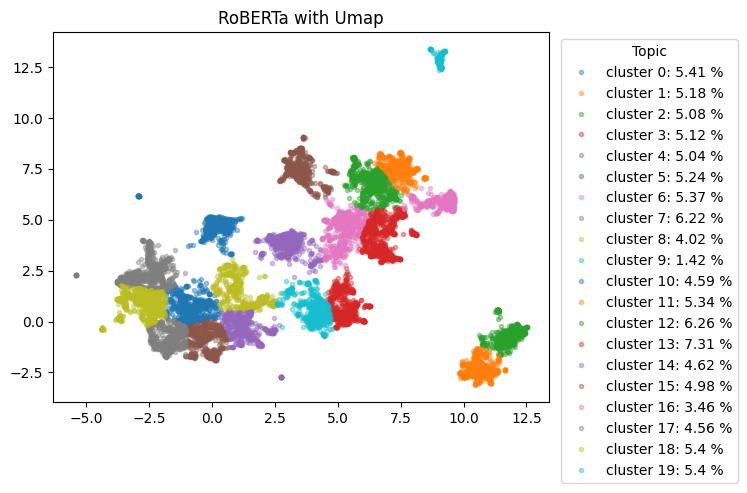

In [118]:
plot_embeddings(embedding_roberta_umap, labels_roberta_umap,"RoBERTa with Umap")

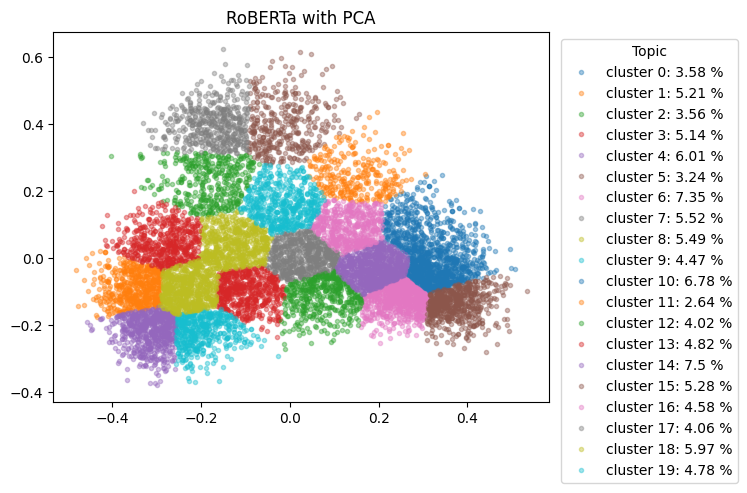

In [119]:
plot_embeddings(embedding_roberta_pca,labels_roberta_pca,"RoBERTa with PCA")

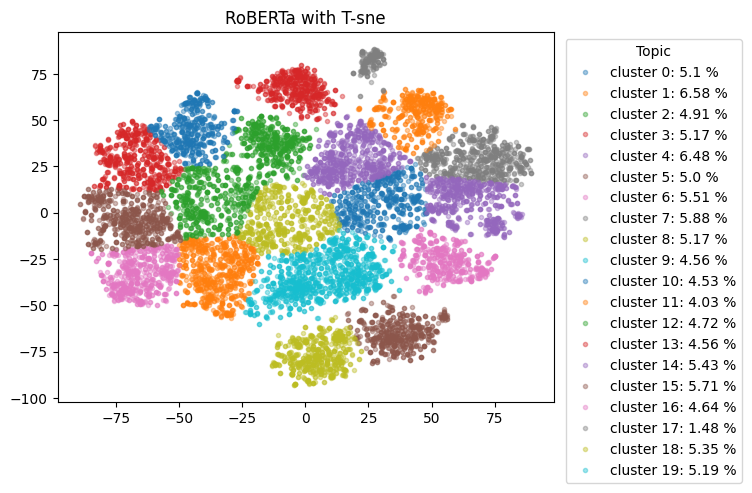

In [120]:
plot_embeddings(embedding_roberta_tsne,labels_roberta_tsne,"RoBERTa with T-sne")

In [121]:
print("Silhouette score:" )
print("Raw RoBERTa" ,silhouette_score(embedding_roberta, labels_roberta_raw) )
print("RoBERTa with Umap" ,  silhouette_score(embedding_roberta_umap, labels_roberta_umap ) )
print("RoBERTa with PCA" ,  silhouette_score(embedding_roberta_pca, labels_roberta_pca) )
print("RoBERTa with Tsne" , silhouette_score(embedding_roberta_tsne, labels_roberta_tsne) )

Silhouette score:
Raw RoBERTa 0.053092916
RoBERTa with Umap 0.46998385
RoBERTa with PCA 0.3277982
RoBERTa with Tsne 0.4064142


## Bertopic

Ref: https://maartengr.github.io/BERTopic/getting_started/quickstart/quickstart.html#quick-start

In [40]:
from sentence_transformers import SentenceTransformer
from bertopic import BERTopic
from umap import UMAP

# Prepare embeddings
docs = sentences
sentence_model = SentenceTransformer("all-MiniLM-L6-v2")
embeddings = sentence_model.encode(docs, show_progress_bar=True)

# Train our topic model using our pre-trained sentence-transformers embeddings
umap_model = UMAP(n_neighbors=15, n_components=2, min_dist=0.0, metric='cosine', random_state=42)
topic_model = BERTopic(umap_model=umap_model, embedding_model=sentence_model)
topics, probs = topic_model.fit_transform(docs, embeddings)

Batches: 100%|██████████| 354/354 [02:50<00:00,  2.08it/s]


Getting only top 20 topics

https://github.com/MaartenGr/BERTopic/blob/master/bertopic/plotting/_documents.py

In [41]:
ntopics = [i for i in range(1,21)] # -1 is outlier
topic_model.get_topic_info()[1:21] 

,Topic,Count,Name,Representation,Representative_Docs
1,0,1101,0_car_bike_cars_dod,"[car, bike, cars, dod, engine, ride, article, ...",[article < @ blaisec @ ( blaise cirelli ) writ...
2,1,527,1_year_baseball_runs_team,"[year, baseball, runs, team, game, pitching, b...","[run completely time , got get prophesies pred..."
3,2,392,2_team_hockey_game_season,"[team, hockey, game, season, gm, flyers, leafs...",[flyers blew lead buffalo sabres second period...
4,3,363,3_encryption_key_clipper_chip,"[encryption, key, clipper, chip, keys, escrow,...",[looks like dorothy denning ideas gotten admin...
5,4,299,4_drive_scsi_drives_disk,"[drive, scsi, drives, disk, ide, controller, h...",[distribution : world : wlsmith @ ( wayne smit...
6,5,292,5_gun_guns_firearms_militia,"[gun, guns, firearms, militia, weapons, amendm...","[open letter paul blackman , research coordina..."
7,6,248,6_fbi_batf_koresh_compound,"[fbi, batf, koresh, compound, fire, children, ...",[article < @ jmd @ ( jim de arras ) writes : a...
8,7,166,7_simms_fpu_simm_nubus,"[simms, fpu, simm, nubus, speed, pds, apple, r...",[ray @ ( ray fischer ) writes : dhk @ ( dave k...
9,8,129,8_cramer_homosexual_gay_men,"[cramer, homosexual, gay, men, sexual, sex, cl...",[article < @ cramer @ ( clayton cramer ) write...
10,9,116,9_space_launch_moon_lunar,"[space, launch, moon, lunar, nasa, commercial,...",[distribution : world : yamauchi @ ( brian yam...


In [45]:
# Run the visualization with the original embeddings
topic_model.visualize_documents(docs, embeddings=embeddings, topics=ntopics)

In [46]:
# Reduce dimensionality of embeddings, this step is optional but much faster to perform iteratively:
umap_embeddings = topic_model.umap_model.transform(embeddings)
topic_model.visualize_documents(docs, reduced_embeddings=umap_embeddings, topics=ntopics)

In [47]:
topic_model.visualize_hierarchy(top_n_topics=num_topics)

In [48]:
topic_model.visualize_barchart(top_n_topics=num_topics)

In [49]:
topic_model.visualize_heatmap(n_clusters=num_topics, width=1000, height=1000)

In [50]:
topic_model.visualize_topics()

Wordcloud

https://github.com/MaartenGr/BERTopic/issues/425#issuecomment-1026540430

In [73]:
from wordcloud import WordCloud

def create_wordcloud_grid(topic_model, topics):
    num_topics = len(topics)
    num_cols = min(num_topics, 3)
    num_rows = (num_topics - 1) // num_cols + 1

    # Create a grid of word clouds
    plt.figure(figsize=(15, 10))
    for i, topic in enumerate(topics):
        text = {word: value for word, value in topic_model.get_topic(topic)}
        wc = WordCloud(background_color="white", max_words=1000)
        wc.generate_from_frequencies(text)
        
        plt.subplot(num_rows, num_cols, i + 1)
        plt.imshow(wc, interpolation="bilinear")
        plt.axis("off")
        plt.title(f"Topic {topic}")

    plt.tight_layout()
    plt.show()


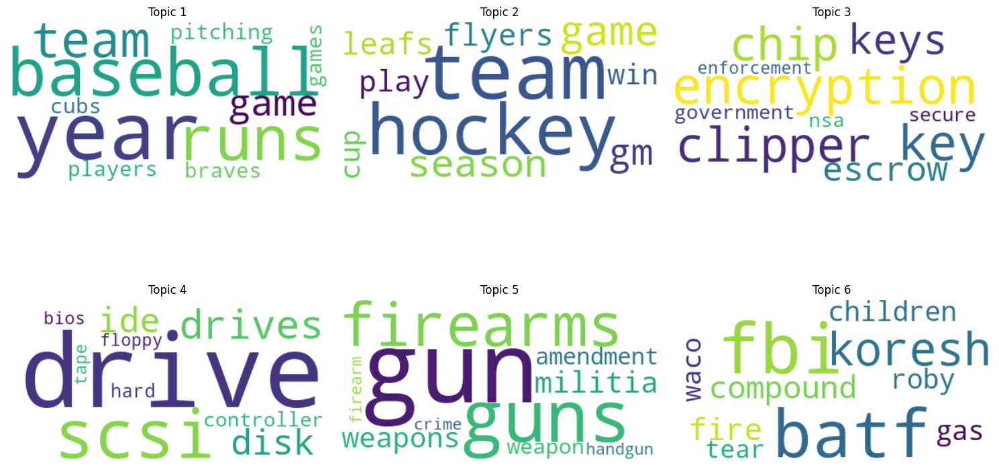

In [74]:
# Creating sample wordcloud for 6 topics
topics = [1,2,3,4,5,6] 
create_wordcloud_grid(topic_model, topics)

Silhouette score 

ref: https://github.com/MaartenGr/BERTopic/issues/428#issuecomment-1027647827

In [51]:
# Generate `X` and `labels` only for non-outlier topics (as they are technically not clusters)
indices = [index for index, topic in enumerate(topics) if topic != -1]
X = umap_embeddings[np.array(indices)]
labels = [topic for index, topic in enumerate(topics) if topic != -1]

# Calculate silhouette score
silhouette_score(X, labels)

0.52160203